In [31]:
import tifffile
from matplotlib import pyplot as plt
get_ipython().run_line_magic('matplotlib', 'inline')

In [60]:
from skimage.filters import rank
from skimage.morphology import disk
import numpy as np

from cil.framework import ImageGeometry, AcquisitionGeometry, AcquisitionData
from cil.plugins.astra import ProjectionOperator
from cil.plugins.astra.processors import FBP
from copy import deepcopy

#%%
imsize = 2016

def reconstruct_one_slice(sino, n_proj=751):
    # set-up ccpi objects
    # multi-channel geometry
    ag_MC = AcquisitionGeometry.create_Parallel2D()
    ag_MC.set_panel(sino.shape[2], pixel_size=0.055)
    ag_MC.set_channels(num_channels=2)
    ag_MC.set_angles(np.linspace(0, 180, n_proj, endpoint=False), angle_unit='degree')
    # allocate AcquisitionGeometry and fill it in with actual sinogram
    ad_MC = ag_MC.allocate()
    ad_MC.fill(sino)
    # generate ImagGeometry
    ig_MC = ag_MC.get_ImageGeometry()
    
    # actual projection operator for iterative reconstruction
    op_MC = ProjectionOperator(ig_MC, ag_MC, 'gpu')

    # single slice geometry
    ag = ag_MC.get_slice(channel=0)
    ig = ag.get_ImageGeometry()

    #%% FBP recon
    FBP_recon = ig_MC.allocate()

    # FBP reconstruction per channel
    for i in range(ig_MC.channels):

        FBP_recon_2D = FBP(ig, ag, 'gpu')(ad_MC.get_slice(channel=i))
        FBP_recon.fill(FBP_recon_2D, channel=i)

        print("Finish FBP recon for channel {}".format(i), end='\r')

    print("\nFBP Reconstruction Complete!")
    # get actual numpy array
    FBP_recon = FBP_recon.as_array()
    
    return FBP_recon


In [33]:
from scipy.signal import convolve2d
from skimage.morphology import diamond

footprint = np.array([[0, 1, 0], 
                      [1, 1, 1], 
                      [0, 1 ,0]])

mask = footprint / footprint.sum()

footprint_l = np.array(diamond(2))

mask_l = footprint_l / footprint_l.sum()

## Best validation inference on train

In [112]:
before = tifffile.imread('/mnt/data/denoising/xeno/corr/all_volumes/Xenopus_13_3p125_ms_exp_750_proj.tif')
after = tifffile.imread('/mnt/data/denoising/xeno/corr/all_volumes_processed/Xenopus_13_3p125_ms_exp_750_proj.tif')

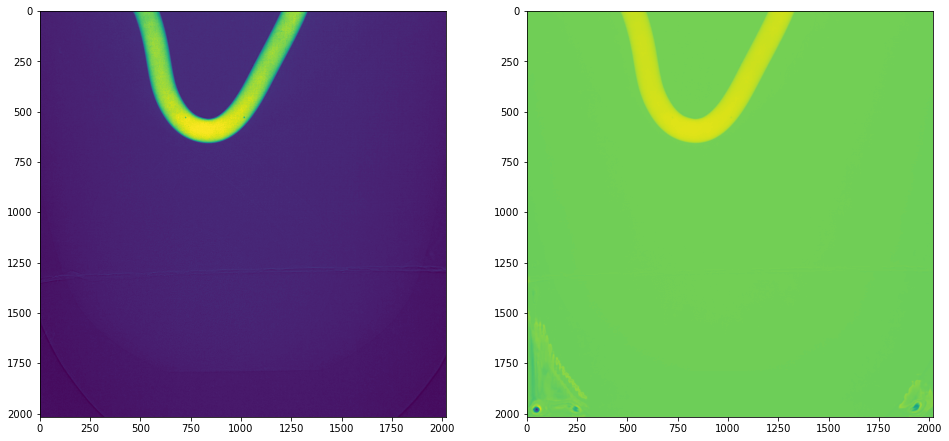

In [113]:
fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(16, 10))
ax1.imshow(before[0])
ax2.imshow(after[0])
plt.show()

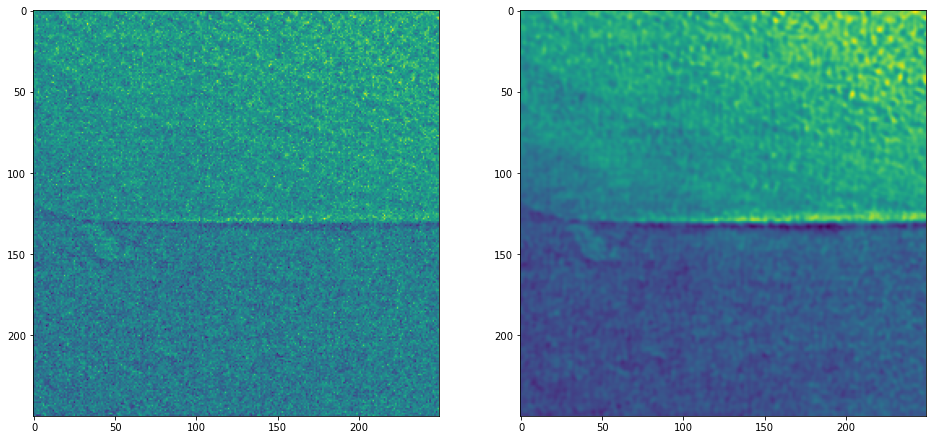

In [132]:
fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(16, 10))
ax1.imshow(before[0][1500:1750, 750:1000])
ax2.imshow(after[0][1500:1750, 750:1000])
plt.show()

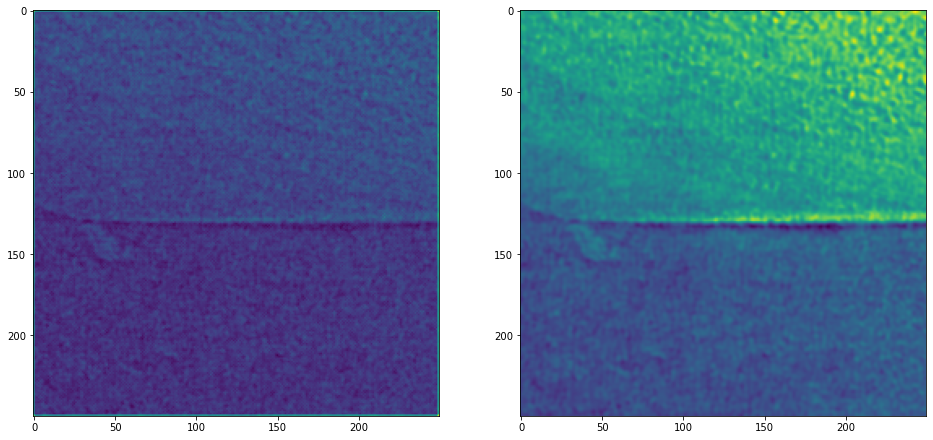

In [133]:
fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(16, 10))
ax1.imshow(convolve2d(before[0][1500:1750, 750:1000], mask, mode='same'))
ax2.imshow(after[0][1500:1750, 750:1000])
plt.show()

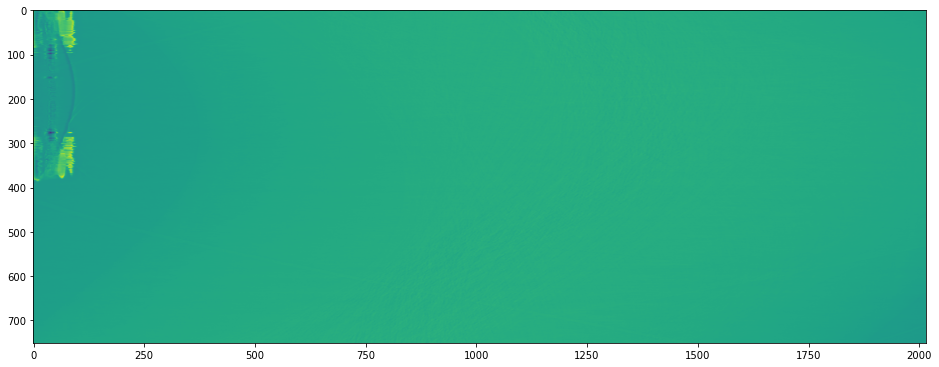

In [134]:
plt.figure(figsize=(16, 10))
plt.imshow(after[:, 1000])

In [117]:
rec_after = reconstruct_one_slice(np.moveaxis(after[:, 1000:1002, 57:], 1, 0))
rec_before = reconstruct_one_slice(np.moveaxis(before[:, 1000:1002, 57:], 1, 0))

Finish FBP recon for channel 1
FBP Reconstruction Complete!
Finish FBP recon for channel 1
FBP Reconstruction Complete!


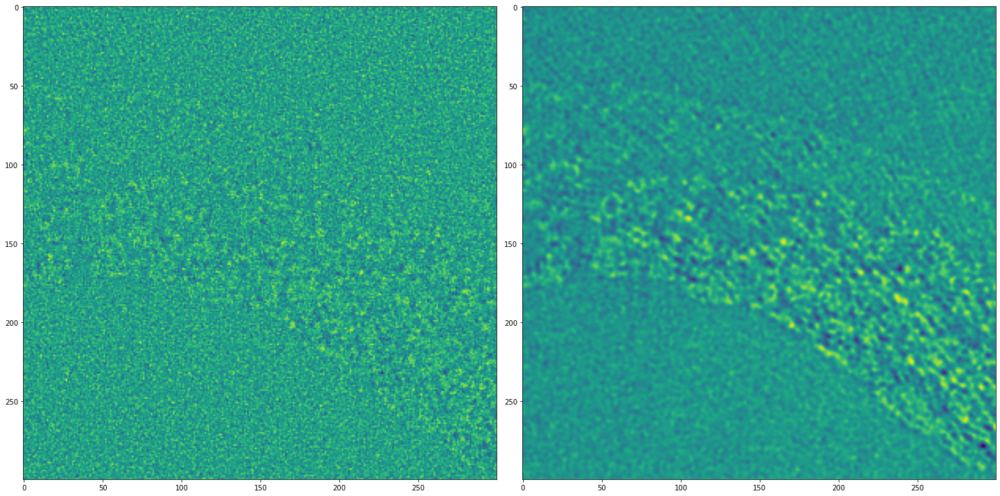

In [118]:
fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(20, 10))
ax1.imshow(rec_before[0][700:1000, 650:950])
ax2.imshow(rec_after[0][700:1000, 650:950])
plt.tight_layout()
plt.show()

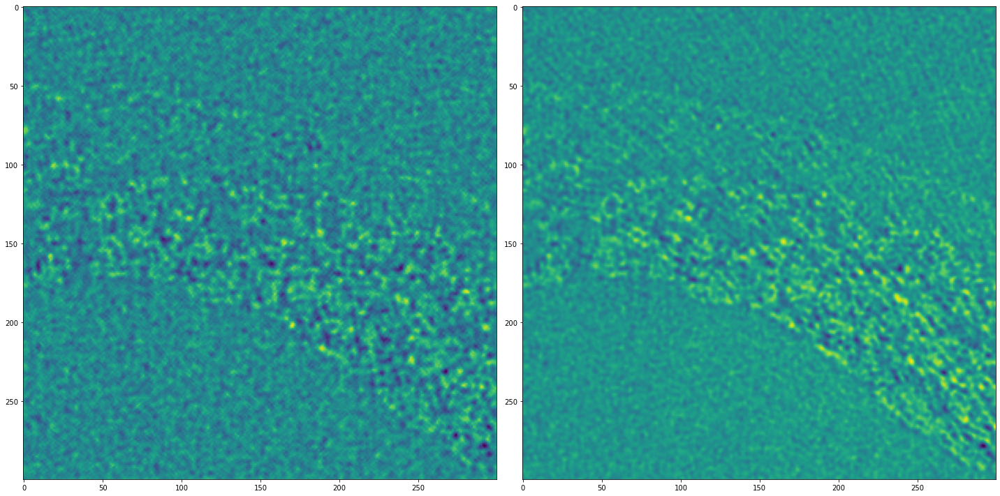

In [119]:
fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(20, 10))
ax1.imshow(convolve2d(rec_before[0][700:1000, 650:950], mask_l, mode='same'))
ax2.imshow(rec_after[0][700:1000, 650:950])
plt.tight_layout()
plt.show()

In [127]:
from skimage.restoration import denoise_nl_means, estimate_sigma

## Best validation inference on validation

In [120]:
before = tifffile.imread('/mnt/data/denoising/xeno/corr/all_volumes/Xenopus_15_3p125_ms_exp_750_proj.tif')
after = tifffile.imread('/mnt/data/denoising/xeno/corr/all_volumes_processed/Xenopus_15_3p125_ms_exp_750_proj.tif')

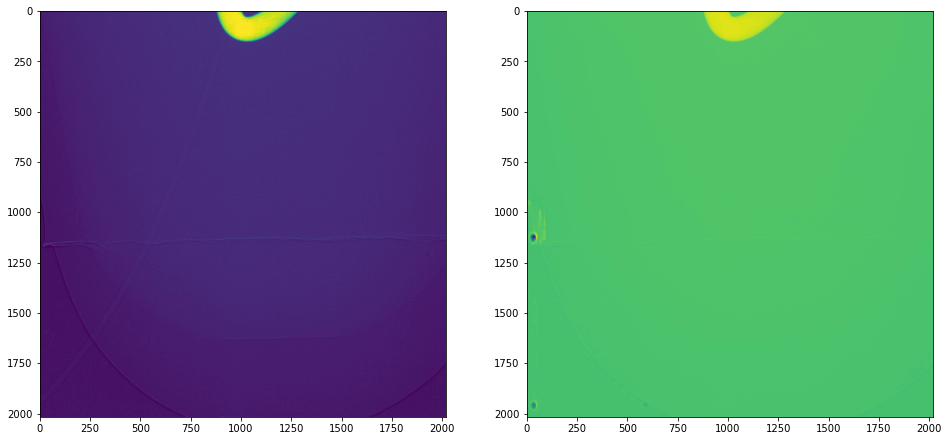

In [121]:
fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(16, 10))
ax1.imshow(before[0])
ax2.imshow(after[0])
plt.show()

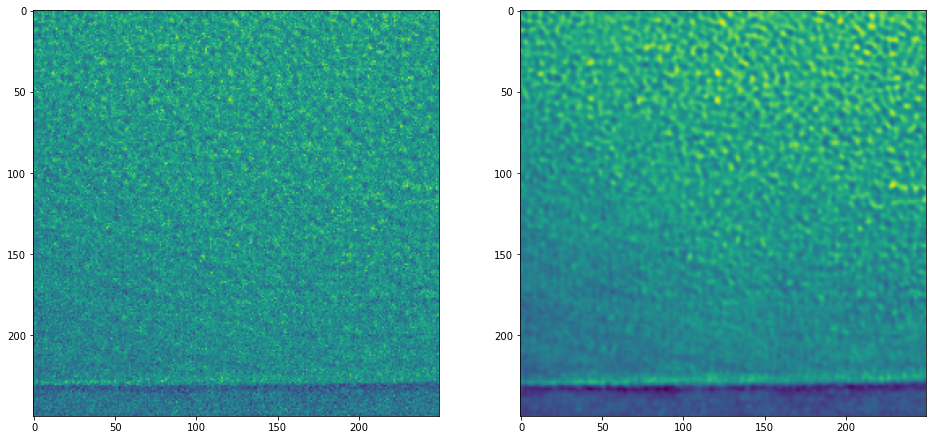

In [139]:
fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(16, 10))
ax1.imshow(before[0][1400:1650, 850:1100])
ax2.imshow(after[0][1400:1650, 850:1100])
plt.show()

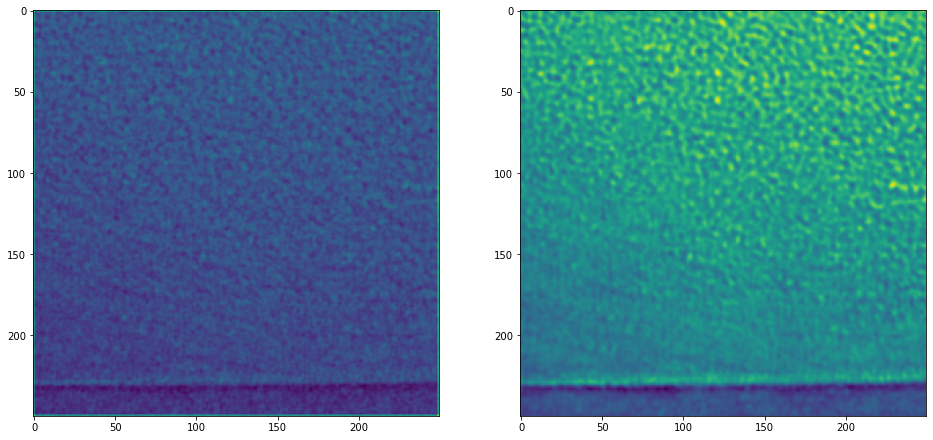

In [140]:
fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(16, 10))
ax1.imshow(convolve2d(before[0][1400:1650, 850:1100], mask, mode='same'))
ax2.imshow(after[0][1400:1650, 850:1100])
plt.show()

In [141]:
rec_after = reconstruct_one_slice(np.moveaxis(after[:, 1000:1002, 57:], 1, 0))
rec_before = reconstruct_one_slice(np.moveaxis(before[:, 1000:1002, 57:], 1, 0))

Finish FBP recon for channel 1
FBP Reconstruction Complete!
Finish FBP recon for channel 1
FBP Reconstruction Complete!


In [190]:
%%time
rb_dnlm = denoise_nl_means(rec_before[0], patch_size=3, patch_distance=100)

CPU times: user 21min 25s, sys: 0 ns, total: 21min 25s
Wall time: 21min 24s


In [193]:
%%time
rb_dnlm2 = denoise_nl_means(rec_before[0], patch_size=7, patch_distance=100)

CPU times: user 21min 38s, sys: 0 ns, total: 21min 38s
Wall time: 21min 37s


In [170]:
rb_sm = convolve2d(rec_before[0], mask, mode='same')

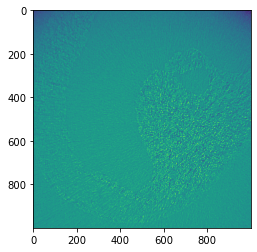

In [161]:
plt.imshow(rec_after[0][200:1200, 500:1500])

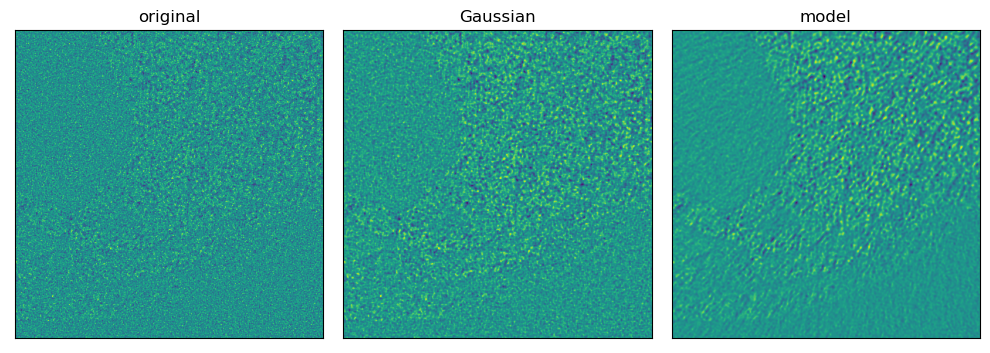

In [189]:
fig, (ax1, ax2, ax3) = plt.subplots(ncols=3, figsize=(10, 7), dpi=100,)
ax1.imshow(rec_before[0][800:1200, 900:1300])
ax1.set_xticks([])
ax1.set_yticks([])
ax1.set_title('original')
ax2.imshow(rb_sm[800:1200, 900:1300])
ax2.set_xticks([])
ax2.set_yticks([])
ax2.set_title('Gaussian')
ax3.imshow(rec_after[0][800:1200, 900:1300])
ax3.set_xticks([])
ax3.set_yticks([])
ax3.set_title('model')
plt.tight_layout()
plt.show()

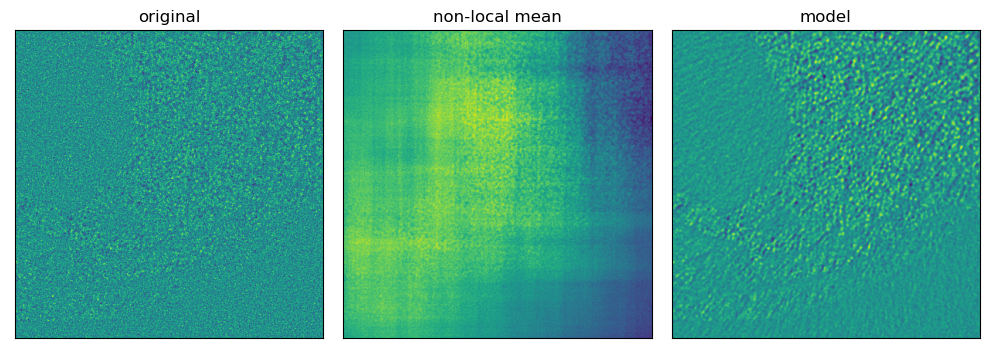

In [196]:
fig, (ax1, ax2, ax3) = plt.subplots(ncols=3, figsize=(10, 7), dpi=100,)
ax1.imshow(rec_before[0][800:1200, 900:1300])
ax1.set_xticks([])
ax1.set_yticks([])
ax1.set_title('original')
ax2.imshow(rb_dnlm[800:1200, 900:1300])
ax2.set_xticks([])
ax2.set_yticks([])
ax2.set_title('non-local mean')
ax3.imshow(rec_after[0][800:1200, 900:1300])
ax3.set_xticks([])
ax3.set_yticks([])
ax3.set_title('model')
plt.tight_layout()
plt.show()

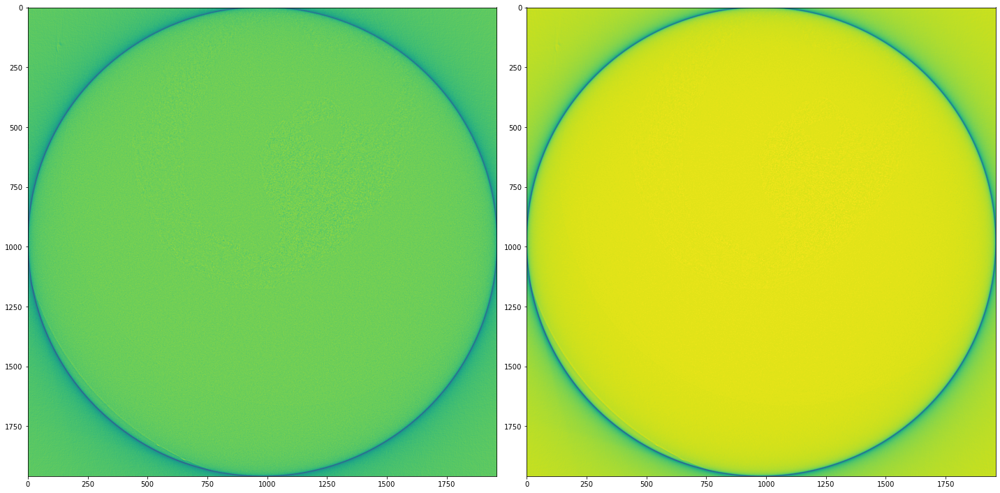

In [55]:
fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(20, 10))
ax1.imshow(rec_before[0])
ax2.imshow(rec_after[0])
plt.tight_layout()
plt.show()

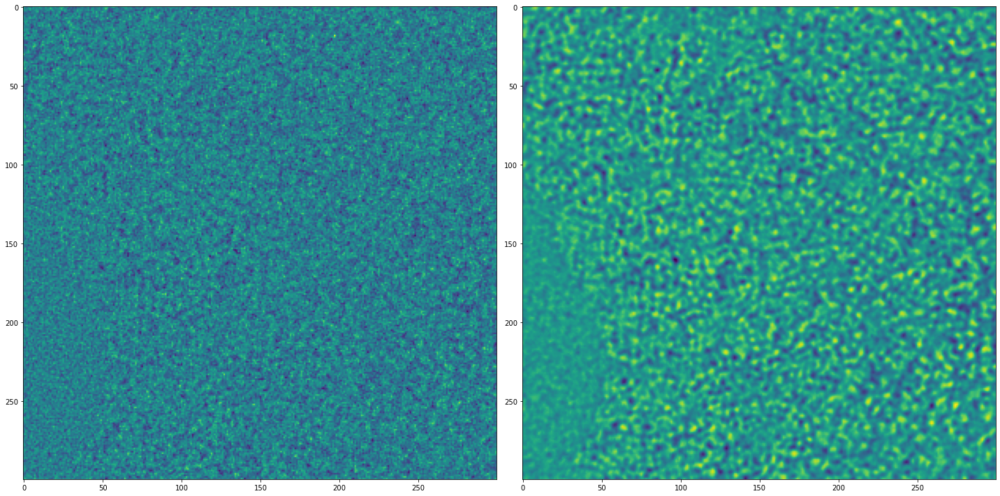

In [56]:
fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(20, 10))
ax1.imshow(rec_before[0][700:1000, 1000:1300])
ax2.imshow(rec_after[0][700:1000, 1000:1300])
plt.tight_layout()
plt.show()

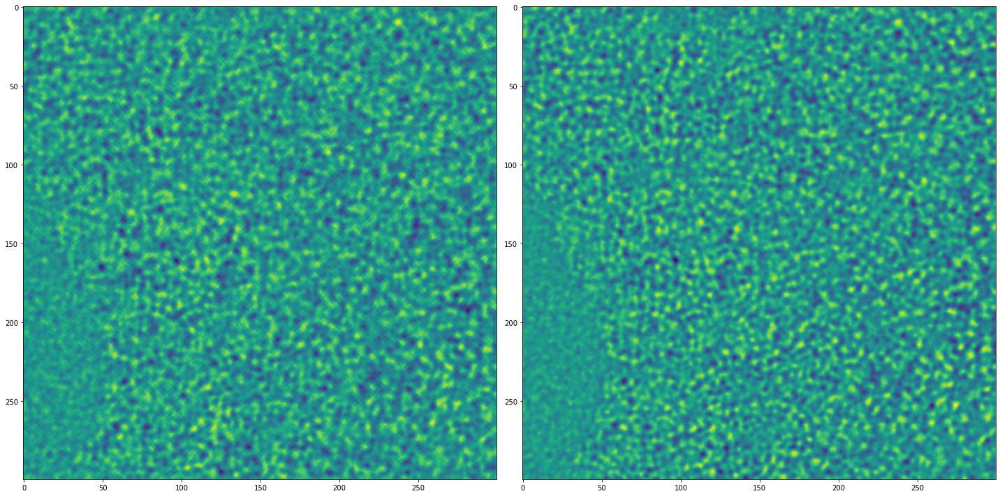

In [62]:
fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(20, 10))
ax1.imshow(convolve2d(rec_before[0][700:1000, 1000:1300], mask_l, mode='same'))
ax2.imshow(rec_after[0][700:1000, 1000:1300])
plt.tight_layout()
plt.show()

## ±Best train inference on train

In [71]:
before = tifffile.imread('/mnt/data/denoising/xeno/corr/all_volumes/Xenopus_13_3p125_ms_exp_750_proj.tif')
after = tifffile.imread('/mnt/data/denoising/xeno/corr/all_volumes_processed/Xenopus_13_3p125_ms_exp_750_proj.tif')

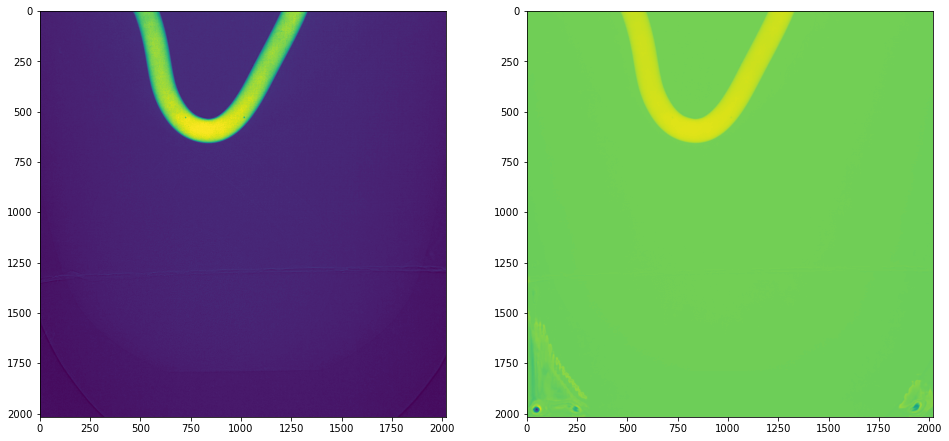

In [73]:
fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(16, 10))
ax1.imshow(before[0])
ax2.imshow(after[0])
plt.show()

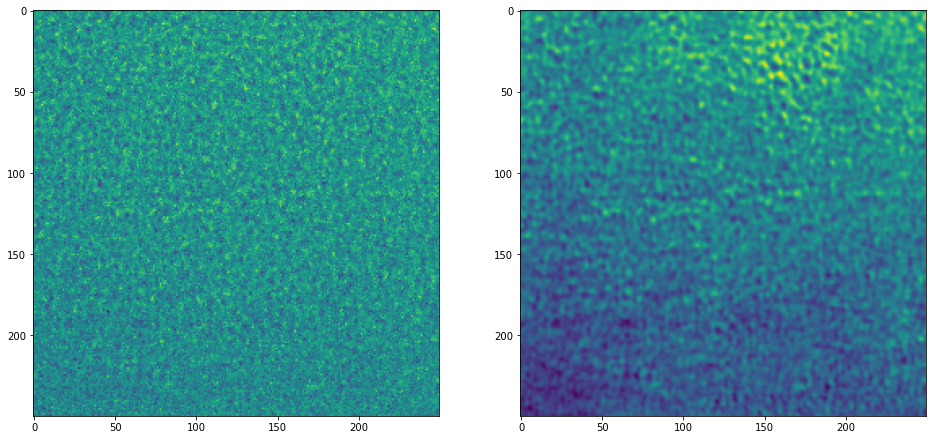

In [74]:
fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(16, 10))
ax1.imshow(before[0][1500:1750, 750:1000])
ax2.imshow(after[0][1500:1750, 750:1000])
plt.show()

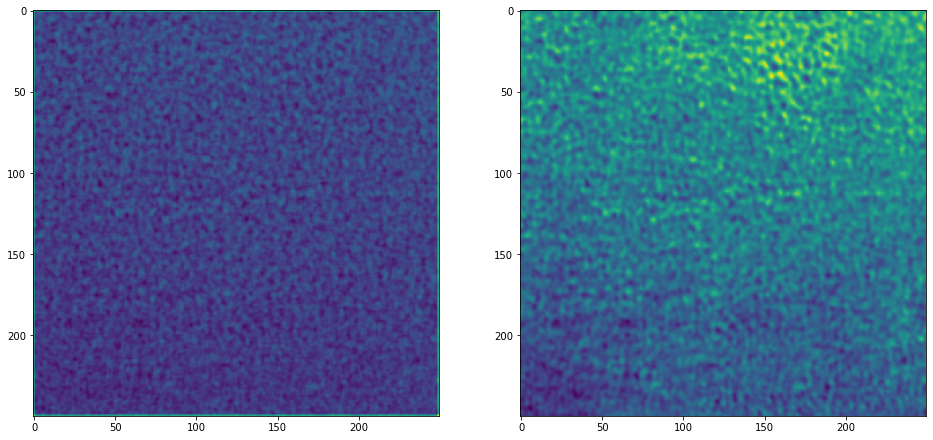

In [76]:
fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(16, 10))
ax1.imshow(convolve2d(before[0][1500:1750, 750:1000], mask, mode='same'))
ax2.imshow(after[0][1500:1750, 750:1000])
plt.show()

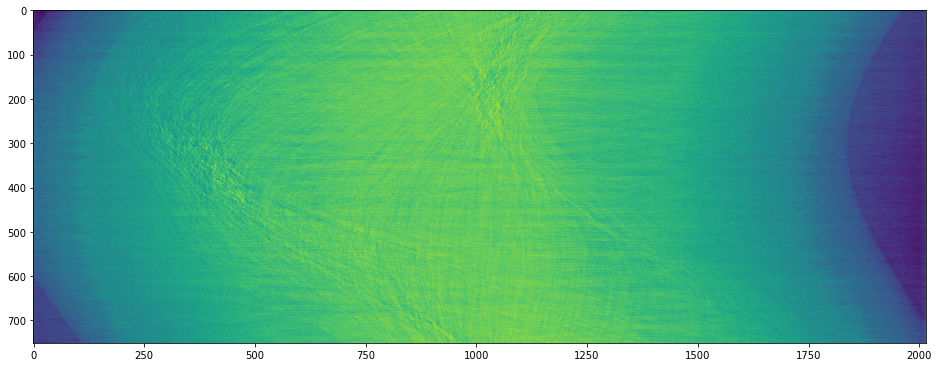

In [77]:
plt.figure(figsize=(16, 10))
plt.imshow(after[:, 1000])

In [78]:
rec_after = reconstruct_one_slice(np.moveaxis(after[:, 1000:1002, 57:], 1, 0))
rec_before = reconstruct_one_slice(np.moveaxis(before[:, 1000:1002, 57:], 1, 0))

Finish FBP recon for channel 1
FBP Reconstruction Complete!
Finish FBP recon for channel 1
FBP Reconstruction Complete!


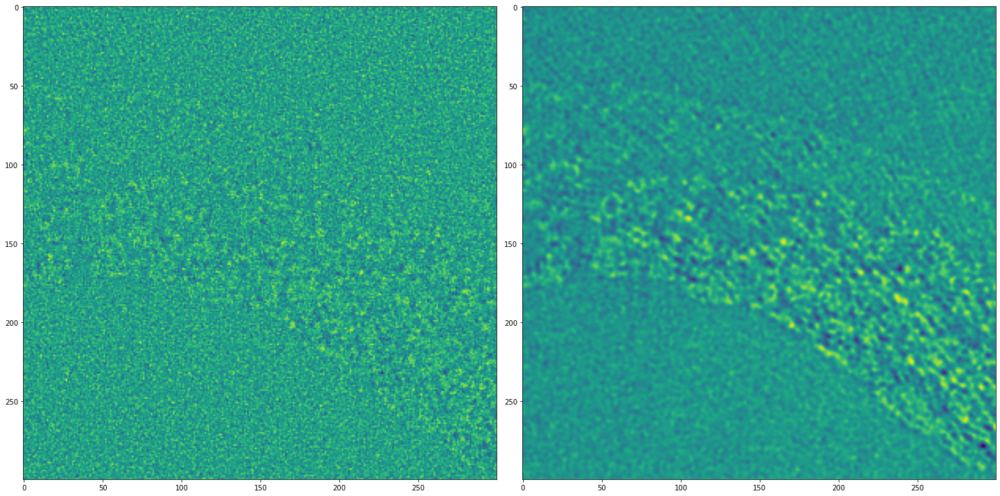

In [79]:
fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(20, 10))
ax1.imshow(rec_before[0][700:1000, 650:950])
ax2.imshow(rec_after[0][700:1000, 650:950])
plt.tight_layout()
plt.show()

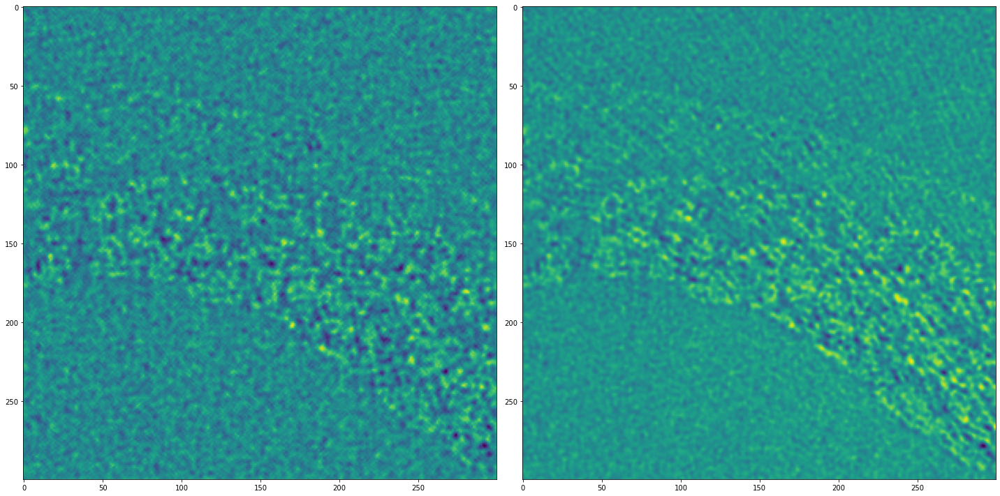

In [80]:
fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(20, 10))
ax1.imshow(convolve2d(rec_before[0][700:1000, 650:950], mask_l, mode='same'))
ax2.imshow(rec_after[0][700:1000, 650:950])
plt.tight_layout()
plt.show()

## ±Best train inference on validation

In [81]:
before = tifffile.imread('/mnt/data/denoising/xeno/corr/all_volumes/Xenopus_15_3p125_ms_exp_750_proj.tif')
after = tifffile.imread('/mnt/data/denoising/xeno/corr/all_volumes_processed/Xenopus_15_3p125_ms_exp_750_proj.tif')

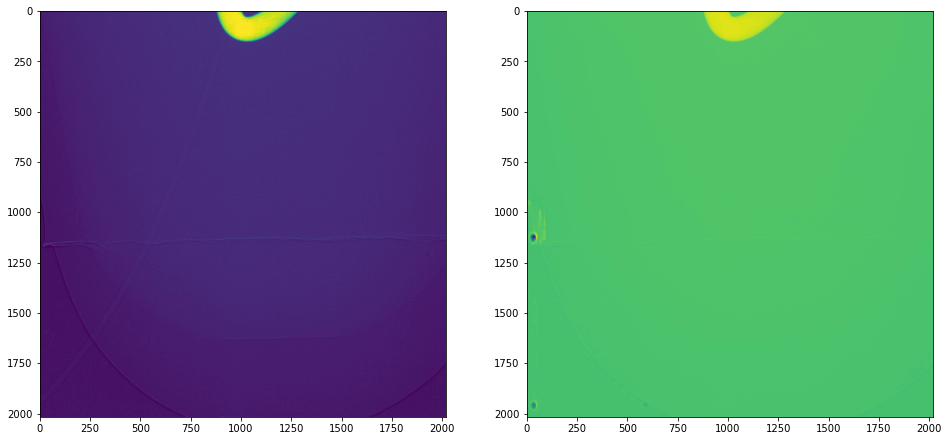

In [82]:
fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(16, 10))
ax1.imshow(before[0])
ax2.imshow(after[0])
plt.show()

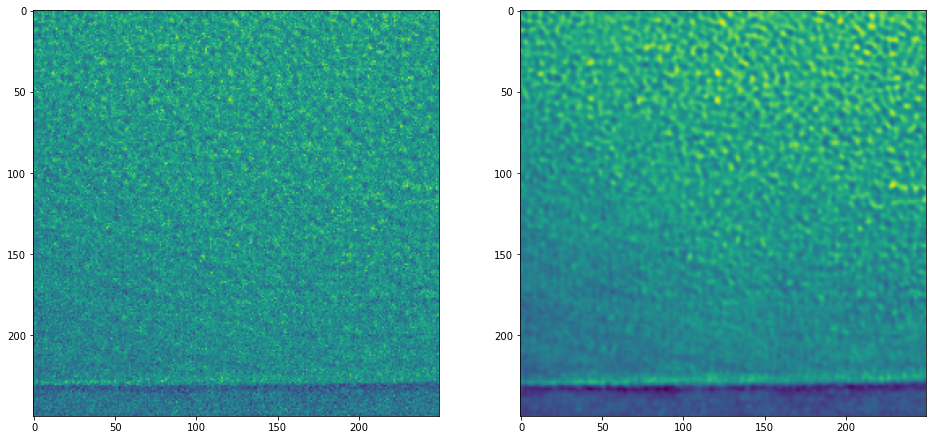

In [83]:
fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(16, 10))
ax1.imshow(before[0][1400:1650, 850:1100])
ax2.imshow(after[0][1400:1650, 850:1100])
plt.show()

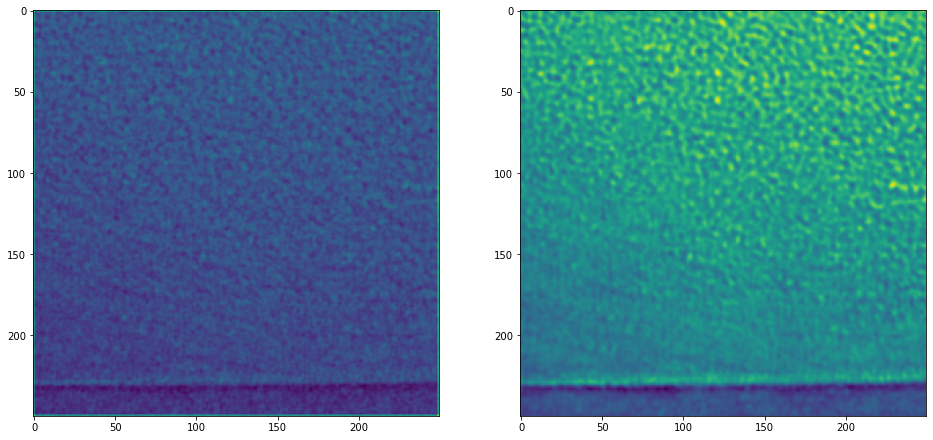

In [84]:
fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(16, 10))
ax1.imshow(convolve2d(before[0][1400:1650, 850:1100], mask, mode='same'))
ax2.imshow(after[0][1400:1650, 850:1100])
plt.show()

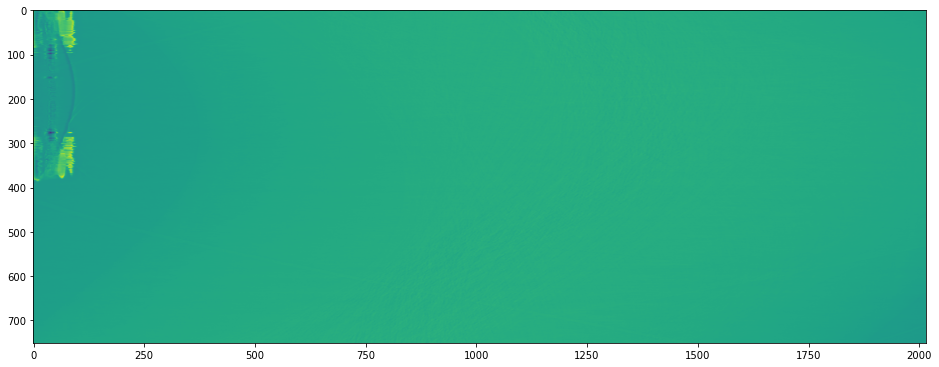

In [85]:
plt.figure(figsize=(16, 10))
plt.imshow(after[:, 1000])

In [86]:
rec_after = reconstruct_one_slice(np.moveaxis(after[:, 1000:1002, 57:], 1, 0))
rec_before = reconstruct_one_slice(np.moveaxis(before[:, 1000:1002, 57:], 1, 0))

Finish FBP recon for channel 1
FBP Reconstruction Complete!
Finish FBP recon for channel 1
FBP Reconstruction Complete!


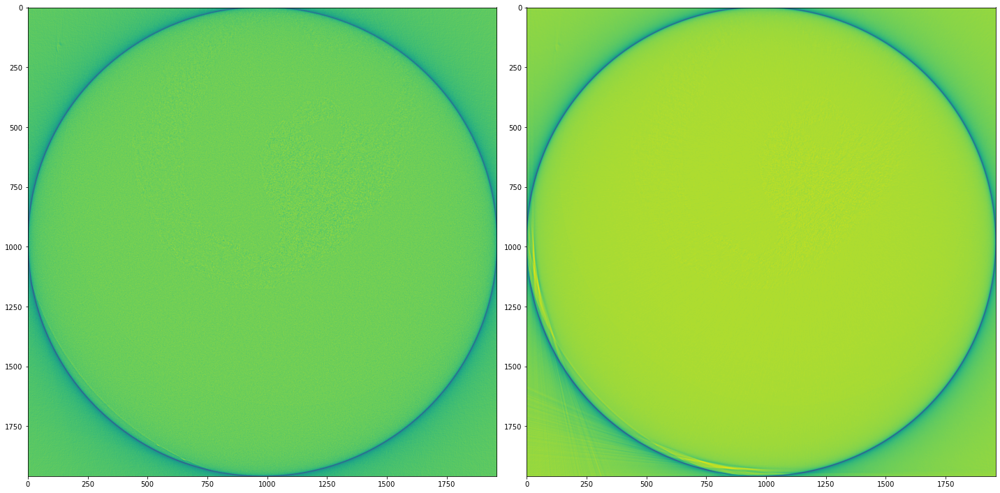

In [87]:
fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(20, 10))
ax1.imshow(rec_before[0])
ax2.imshow(rec_after[0])
plt.tight_layout()
plt.show()

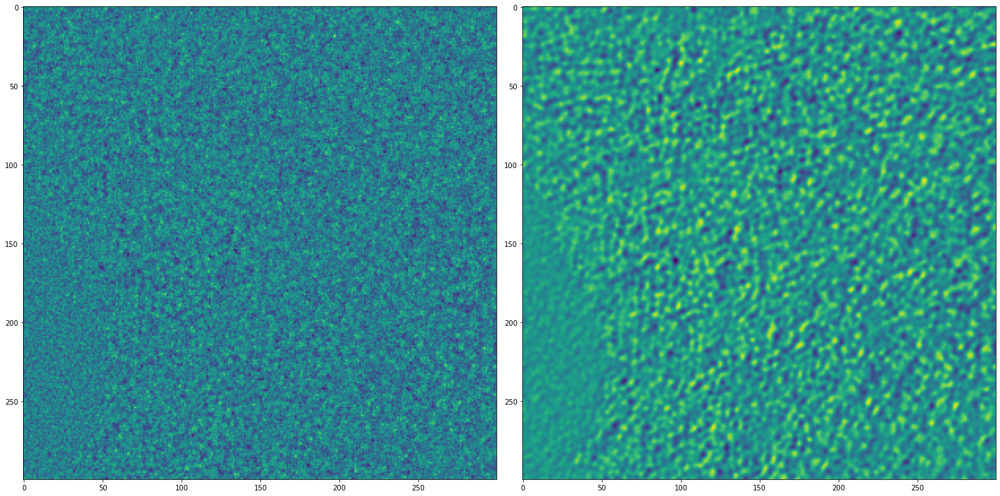

In [88]:
fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(20, 10))
ax1.imshow(rec_before[0][700:1000, 1000:1300])
ax2.imshow(rec_after[0][700:1000, 1000:1300])
plt.tight_layout()
plt.show()

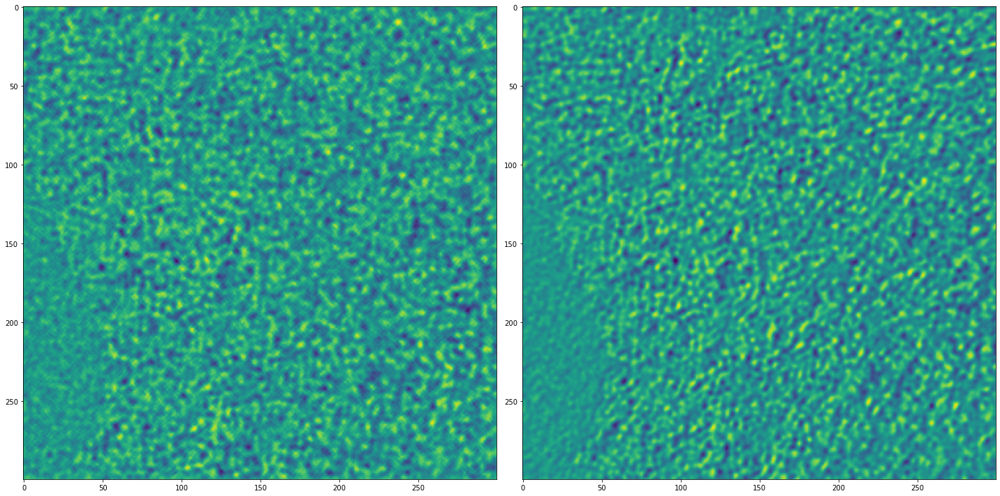

In [89]:
fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(20, 10))
ax1.imshow(convolve2d(rec_before[0][700:1000, 1000:1300], mask_l, mode='same'))
ax2.imshow(rec_after[0][700:1000, 1000:1300])
plt.tight_layout()
plt.show()

## Newer samples

In [55]:
before = tifffile.imread('/mnt/HD-LSDF/Xenopus/2021_11_Xenopus/test_janes/Xenopus_3_v2/4/radios_corrected/scaled_0.tif')
after = tifffile.imread('/mnt/HD-LSDF/Xenopus/2021_11_Xenopus/test_janes/Xenopus_3_v2/4/radios_corrected/denoized_scaled_0.tif')

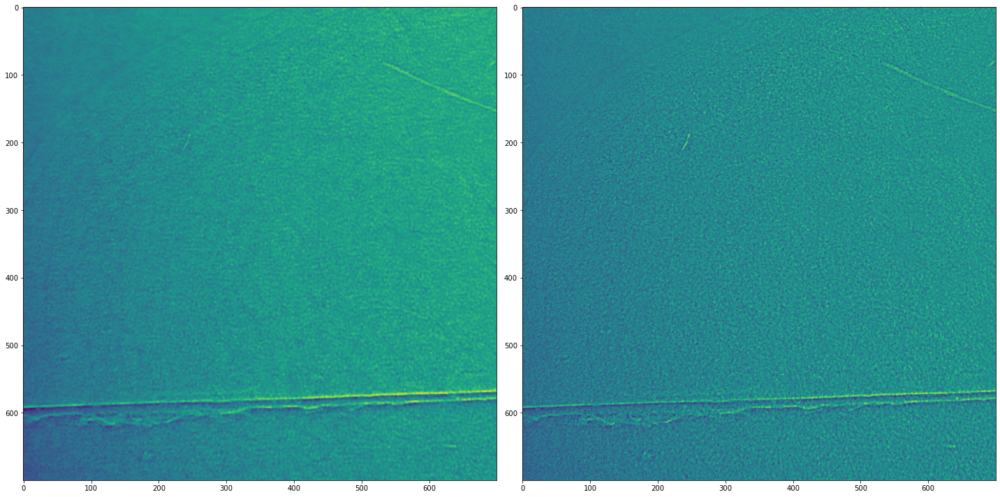

In [58]:
y, x = 800, 250
s = 700
fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(20, 10))
ax1.imshow(after[0, y:y+s, x:x+s])
ax2.imshow(before[0, y:y+s, x:x+s])
plt.tight_layout()
plt.show()

In [102]:
before = tifffile.imread('/mnt/HD-LSDF/Xenopus/2021_11_Xenopus/test_janes/Xenopus_3_v2/1/radios_corrected/scaled_0.tif')
# after = tifffile.imread('/mnt/HD-LSDF/Xenopus/2021_11_Xenopus/test_janes/Xenopus_3_v2/4/radios_corrected/denoized_scaled_0.tif')